# Feature Engineering and Exploratory Analysis
Datasets:
 - Comisión Nacional Bancaria y de Valores (National Banking and Securities Commission) September 2024 Financial Inclusion
 - Instituto Nacional de Estadística y Geografía – Infraestructura de Datos Espaciales para la Consulta de Información Territorial (National Institute of Statistics and Geography – Spatial Data Infrastructure for Territorial Information Query) (2020)

In [1]:
import pandas as pd
from scipy.stats.mstats import winsorize
import json
import unidecode

## Importing and combining datasets

In [2]:
## Aggregate all municipal level data. Right now it's just the CNBV and INEGI ITER (census) datasets.
# Import CNBV dataset (2024)
CNBV_df = pd.read_csv(r'datasets/CNBV_allsector_data.csv')

# Drop last row of junk data
CNBV_df = CNBV_df.drop(CNBV_df.index[-1])

# Import INEGI dataset (2020)
INEGI_df = pd.read_csv(r'datasets\INEGI_ITER2020_data.csv')

# Merge into one dataframe for feature engineering and analysis
main_df = pd.merge(CNBV_df, INEGI_df, how='left', left_on = 'Municipality Code', right_on = 'mun_code')
main_df = main_df.drop(columns = ['mun_code', 'NOM_ENT', 'NOM_MUN'])

In [3]:
# Wikipedia says there's 2464 municipalities, or 2478 if Mexico City's 16 boroughs are counted. The 2469 figure appears in other sources, though, and there doesn't seem to be any empty rows or duplicates.
print(f"Unique Municipalities: {main_df['Municipality Code'].nunique()}")
# Population statistics make sense (no municipalities with 0 people, or 9999999999)
main_df['Population'].describe()

Unique Municipalities: 2469


count    2.469000e+03
mean     5.103849e+04
std      1.469907e+05
min      8.100000e+01
25%      4.489000e+03
50%      1.355200e+04
75%      3.528400e+04
max      1.922523e+06
Name: Population, dtype: float64

## Determining Financial Inclusion From the CNBV Dataset

The Global Partnership for Financial Inclusion uses the "G20 Basic Set of Financial Inclusion Indicators": <br>

1) Formally banked adults: Percentage of adults with an account at a formal financial institution
2) Adults with credit from regulated institutions: Percentage of adults with at least one loan outstanding from a financial institution   
3) Formally banked enterprises: Number or percentage of SMEs (small or medium-sized enterprises) with accounts
4) Enterprises with outstanding loan from a regulated financial institution: Number or percentage of SMEs with outstanding loan
5) Points of service: Number of branches per 100,000 adults

(taken from https://www.worldbank.org/en/topic/financialinclusion/brief/how-to-measure-financial-inclusion)

Also, the following questions were suggested in the Slack discussion:

- What is the distribution of bank account ownership like across different states / territories? Are there any correlations with education level, urbanization rates, etc.?
- Are there any significant rural - urban divides in terms of financial inclusion?
- Are there any interesting correlations between labor force demographics and financial inclusion across states / territories?
- What relationship exists between financial inclusion metrics (account ownership, saving and borrowing behavior, credit access, digital payment adoption, mobile money usage, etc.)
- Which demographic factors (e.g. age, gender, education, etc.) are the strongest predictors of financial inclusion? (TBD: not sure how much individual-level data exists to answer this.)
- How do savings and borrowing behaviors differ across income groups, education levels, and states / territories? Across communities?
- Are there any correlations between financial inclusion / economic opportunity and urban trends (e.g. digital payment incentives, gentrification)?
- Are there any interesting relationships between infrastructure (e.g. access to electricity, internet access, use of mobile phones) and financial inclusion?
- What relationships exist between access to credit, credit usage, etc. and small business ownership and entrepreneurship?

I'm going to focus on the Financial Inclusion Indicators first.


In [4]:
# Criteria 1, banked adults. CNBV and GPFI both define adults as 15+ years old.

# Problem-- this dataset just has the number of each type of account, not the number of individuals with accounts. Which type of account is most popular?
# Determine by looking at highest sums.
CNBV_df.sum(numeric_only=True).sort_values(ascending=False)

POS Transactions                            350969515
Banking - Debit Card Accounts               186155365
ATM Transactions                            185949134
Total - Total Accounts                      173981235
Population                                  126014024
Banking - Transactional Accounts Level 4    106552652
Accounts with Mobile Transactions            96631971
Adult Population                             93985354
Total - Total Loans                          78935090
Adult Population (Women)                     48732991
Municipality Code                            47711363
Adult Population (Men)                       45252363
Banking - Credit Cards                       36740143
Banking - Transactional Accounts Level 2     26384629
EACP - Demand Deposit Accounts               19522510
Banking - Personal Loans                     13751264
EACP - Savings Accounts                      11991622
EACP - Debit Card Accounts                    8662306
EACP - Credit Cards         

There are more debit cards and transactional accounts (Level 4) than there are people in Mexico-- using number of accounts will certainly overestimate the number of banked individuals.

On the subject of transactional accounts: these are categories regulated by the Mexican government with higher level accounts requiring more documentation to open, but providing more services and having less restrictions on transactions. Lower tiers exist to meet the needs of lower income individuals with caps in place to prevent them being used for things like money laundering. The different tiers are summarized in English in [this blog post from 2013](https://www.cgap.org/blog/mexicos-tiered-kyc-update-on-market-response) (the specific information may be outdated)


<img src="tiered_scheme.avif" width="500"/>


My reading is that these are an important part of the picture of financial inclusion in Mexico. However, since they're unique to the country, and the number of accounts is noticeably greater than the total population, I don't think they'll serve as the best metric for "banked inviduals". The same logic applies to debit cards.

Looking at the data I have available and the relative sums, the proxies I'm initially thinking of: 

- Criterion 1 (banked adults): Total number (banking + EACP) of savings accounts per adult. They appear to be reasonably common without a large amount of obvious duplication, are easily defined, and are a fundamental financial service.

- Criterion 2 (adults with credit): Total number of credit cards per adult. This almost certainly double-counts individuals, but I believe it's better to use than the other loan categories.

- Criterion 3 (banked SME): Businesses with POS terminals. This is likely to overcount in some ways (some POS terminals are going to be in large enterprises-- [Wikipedia](https://en.wikipedia.org/wiki/Walmart_de_M%C3%A9xico_y_Centroam%C3%A9rica) says that Walmart operates about 3000 stores in Mexico). However, there are probably some small businesses that do not rely on POS terminals, which hopefully balances this out. I think the metric generally captures the spirit of the criterion and will reflect the commercial presence in an area.

- Criterion 4 (SMEs with regulated loans): Number of commercial loans. Unfortunately, these only appear in the EACP category. EACP stands for Entidades de Ahorro y Crédito Popular, which translates to Popular Savings and Credit Institutions. This term is regulated by the Mexican government, and is a financial sector specifically dedicated to serving those with less access to commercial banking. I'm a little worried this metric could indicate the opposite of what it's supposed to-- it's possible that EACP commercial loans are higher in more financially excluded areas.

- Criterion 5 (Bank branches per 100,000 adults): This metric is actually contained in the data set! I'm just going to do per person rather than per 100,000 for consistency with the other 4 proxies.


In [5]:
### Calculating the criteria

main_df['Savings Accounts per Adult'] = (main_df['EACP - Savings Accounts'] + main_df['Banking - Savings Accounts']) / main_df['Adult Population'] # Criterion 1
main_df['Credit Cards per Adult'] = (main_df['EACP - Credit Cards'] + main_df['Banking - Credit Cards']) / main_df['Adult Population'] # Criterion 2
main_df['Debit Cards per Adult'] = (main_df['EACP - Debit Card Accounts'] + main_df['Banking - Debit Card Accounts']) / main_df['Adult Population'] # Probably also interesting
# Criterion 3 does not need to be calculated (main_df['Businesses with POS Terminals']))
# Criterion 4 does not to be calculated (main_df['EACP - Commercial Loans'])
main_df['Banks per Adult'] = main_df['Bank Branches'] / main_df['Adult Population']

I'm going to perform some additional feature engineering, mainly with the goal of looking for any interesting correlations.

There are two categorical variables in the dataset:
- **Type of Population** - Categorized as below according to the CNBV Excel document. May prove useful for categorizing municipalities later, but no need to encode these variables for analysis since I already have raw population data.
    - Rural: Less than or equal to 5,000 inhabitants
    - In transition: From 5,001 to 15,000 inhabitants
    - Semi-urban: From 15,001 to 50,000 inhabitants
    - Urban: From 50,001 to 300,000 inhabitants
    - Semi-metropolis: From 300,001 to 1 million inhabitants
    - Metropolis: Greater than 1 million inhabitants

- **Social Lag Index (Índice de rezago social)** -  Translated from CNBV document: "To categorize municipalities by degree of social backwardness, the 2020 Social Backwardness Index (IRS) published by the National Council for the Evaluation of Social Development Policy (CONEVAL) was considered. This is a weighted measure that summarizes four indicators of social deprivation (educational backwardness, access to health services, access to basic services in housing, as well as quality and space in housing) in a single index". Categories correspond to "very low", "low", "medium", "high", and "very high" in Spanish. I'm going to encode them from 0 to 4.


In [6]:
### Other feature engineering
# ratio of men to women (actually seems to vary quite a bit... from about 0.62 to 1.35)
main_df['Adult Gender Ratio'] = main_df['Adult Population (Men)'] / main_df['Adult Population (Women)']

# Total accounts and loans in banking and EACPs
banking_account_cols = [
    'Banking - Savings Accounts',
    'Banking - Term Deposit Accounts',
    'Banking - Transactional Accounts Level 1',
    'Banking - Transactional Accounts Level 2',
    'Banking - Transactional Accounts Level 3',
    'Banking - Transactional Accounts Level 4',
    'Banking - Debit Card Accounts'
]

banking_loan_cols = [
    'Banking - Credit Cards',
    'Banking - Personal Loans',
    'Banking - Payroll Loans',
    'Banking - ABCD Loans',
    'Banking - Group Loans',
    'Banking - Mortgage Loans',
    'Banking - Auto Loans'
]

eacp_account_cols = [
    'EACP - Savings Accounts',
    'EACP - Term Deposit Accounts',
    'EACP - Demand Deposit Accounts',
    'EACP - Debit Card Accounts'
]

eacp_loan_cols = [
    'EACP - Credit Cards',
    'EACP - Consumer Loans',
    'EACP - Housing Loans',
    'EACP - Commercial Loans'
]

main_df['Banking - Total Accounts'] = main_df[banking_account_cols].sum(axis=1)
main_df['Banking - Total Loans'] = main_df[banking_loan_cols].sum(axis=1)
main_df['EACP - Total Accounts'] = main_df[eacp_account_cols].sum(axis=1)
main_df['EACP - Total Loans'] = main_df[eacp_loan_cols].sum(axis=1)


# Encode 'Type of Population' as 'Urbanization Level'
urbanization_map = {
    'Rural': 0,
    'En Transición': 1,
    'Semi-urbano': 2,
    'Urbano': 3,
    'Semi-metrópoli': 4,
    'Metrópoli': 5
}
main_df['Urbanization Level'] = main_df['Type of Population'].map(urbanization_map)

# Encode 'Social Backwardness Index'.
backwardness_map = {
    'Muy bajo': 0,
    'Bajo': 1,
    'Medio': 2,
    'Alto': 3,
    'Muy alto': 4
}

main_df['Social Lag (Numeric)'] = main_df['Social Lag Index'].map(backwardness_map)

# Normalize additional columns to "per Adult"
cols_to_normalize = [
    'Banking Agents',
    'Bank Branches',
    'Banking - Total Accounts',
    'Banking - Total Loans',
    'EACP - Total Accounts',
    'EACP - Total Loans',
    'ATMs',
    'POS Terminals',
    'Businesses with POS Terminals',
    'Accounts with Mobile Transactions',
    'ATM Transactions',
    'POS Transactions',
    'EACP - Commercial Loans',
]

main_df[[f'{col} per Adult' for col in cols_to_normalize]] = main_df[cols_to_normalize].div(main_df['Adult Population'], axis=0)



Correlation plot with all variables is basically illegible, but does show that most financial metrics are correlated. 

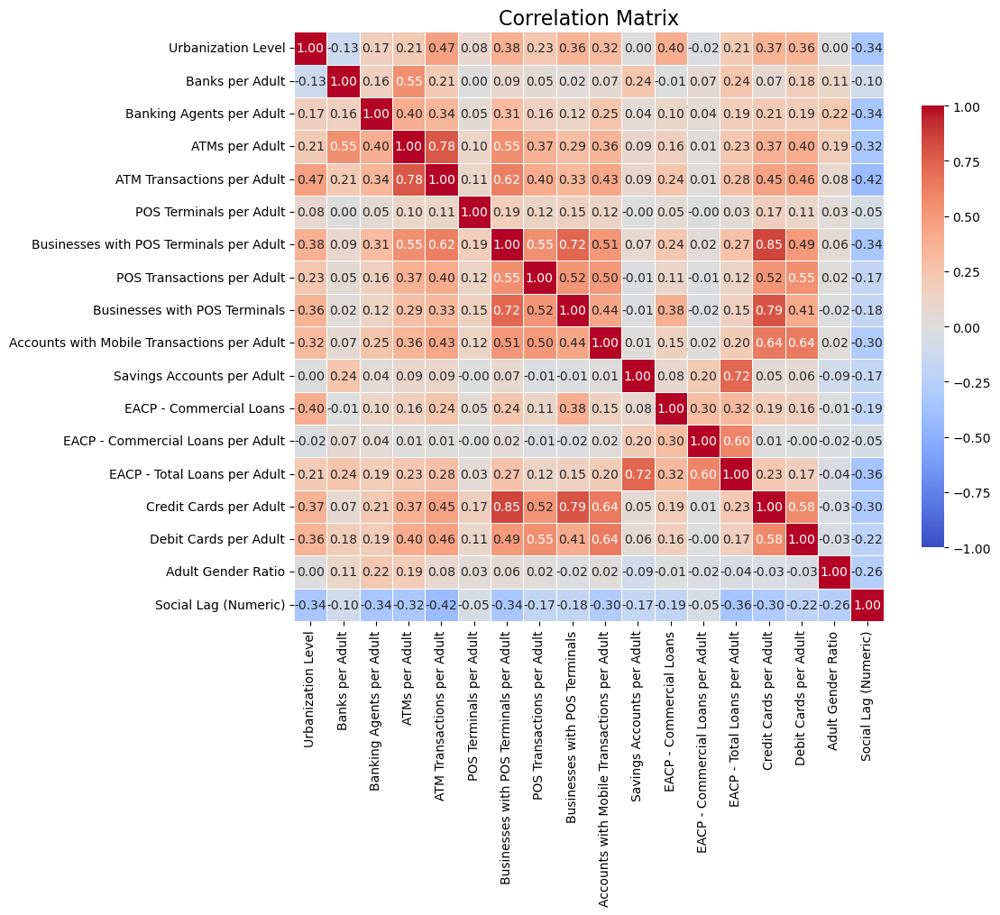

In [7]:
# Create correlation matrix for selected values from the CNBV data
corr_columns = ['Urbanization Level',
       'Banks per Adult', 'Banking Agents per Adult',
       'ATMs per Adult', 'ATM Transactions per Adult', 
       'POS Terminals per Adult', 'Businesses with POS Terminals per Adult',
       'POS Transactions per Adult', 'Businesses with POS Terminals',
       'Accounts with Mobile Transactions per Adult',
       'Savings Accounts per Adult', 'EACP - Commercial Loans',
       'EACP - Commercial Loans per Adult', 'EACP - Total Loans per Adult',
       'Credit Cards per Adult', 'Debit Cards per Adult',
       'Adult Gender Ratio', 'Social Lag (Numeric)']

correlation_matrix = main_df[corr_columns].corr()

import seaborn as sns
import matplotlib.pyplot as plt

# Create a heatmap of the correlation matrix
plt.figure(figsize=(12, 10))
sns.heatmap(
    correlation_matrix,
    annot=True,
    cmap='coolwarm',
    fmt=".2f",
    linewidths=0.5,
    vmin=-1,
    vmax=1,
    center=0,
    square=True,
    cbar_kws={"shrink": 0.75}
)
plt.title('Correlation Matrix', fontsize=16)
plt.tight_layout()
plt.show()

After looking at the data more thoroughly, I've rethought some of the criteria. I think capturing a full picture of financial inclusion with the data available is better than imperfectly trying to match the criteria used in other sources.
- Debit card accounts are common to the point where there's certainly people with more than one, and the number is already correlated with number of credit cards. I'm dropping debit cards as a primary criterion.
- I'm replacing "Banks per Adult" with "Banking Agents per Adult".
- Instead, I'm adding "Accounts with Mobile Transactions per Adult". This seems like an important part of modern financial inclusion, and I think it'll have some interesting correlations with the infrastructure data I found.
- I'm making the assumption that "Social Lag" (related to education, healthcare, and housing) is probably correlated to financial exclusion. Pretty much all accounts, loans, and cards are negatively correlated with social lag, which makes me feel better about condensing values and dropping some. The exception to this is are term deposit accounts and lower-level (3 and below) transactional accounts. Term deposits could be seen as safer by low income individuals, or be encouraged by financial institutions serving low income communities. Lower level transactional accounts are specifically designed to serve people who might not have access to full service banking.
- I'm going to normalize "Commercial Loans" and "Businesses with POS Terminals" to "per Adult" to match the other metrics and not introduce a bias towards populated areas, despite this not being part of the original GPFI criteria.
- Just out of curiousity, I'm going to calculate a metric for "Banking" (commercial) and "EACP" (community-based) activity. There could be an interesting relationship-- maybe EACPs are more active in areas neglected by traditional banking?

## Financial Inclusion Index Calculation

In [8]:
## Determine relative activities of commercial banking vs EACPs
# Calculate z-scores in preparation for "activity" columns
zscore_cols = ['EACP - Total Accounts per Adult', 'EACP - Total Loans per Adult', 'Banking - Total Accounts per Adult', 'Banking - Total Loans per Adult']
main_df[[f'z - {col}' for col in zscore_cols]] = main_df[zscore_cols].apply(lambda x: (x - x.mean()) / x.std())

main_df['EACP Activity'] = main_df['z - EACP - Total Accounts per Adult'] + main_df['z - EACP - Total Loans per Adult']
main_df['Banking Activity'] = main_df['z - Banking - Total Accounts per Adult'] + main_df['z - Banking - Total Loans per Adult']
main_df['EACP vs Banking Imbalance'] = main_df['EACP Activity'] - main_df['Banking Activity']

## Calculate overall "Financial Inclusion" metric for simple comparison, based on the criteria outlined above
# Weight of each metric. The latter two are weighted less because I think they're less relevant, and they're also more compromised relative to the GFPI criteria.
weights = {
    'Savings Accounts per Adult': 0.2,
    'Credit Cards per Adult': 0.2,
    'Accounts with Mobile Transactions per Adult': 0.2,
    'Banking Agents per Adult': 0.2,
    'EACP - Commercial Loans per Adult': 0.1,
    'Businesses with POS Terminals per Adult': 0.1,
}

# List of metrics for Financial Inclusion (from weights keys)
FI_metric_cols = list(weights.keys())

# Z-scores
z_scores = (main_df[FI_metric_cols] - main_df[FI_metric_cols].mean()) / main_df[FI_metric_cols].std()

# Raw FII
main_df['Financial Inclusion Index - Raw'] = (z_scores * pd.Series(weights)).sum(axis=1)

# Winsorized z-scores
win_threshold = 0.005
z_scores_winsorized = z_scores.apply(lambda col: winsorize(col, limits=[win_threshold, win_threshold]))

# Winsorized FII
main_df['Financial Inclusion Index'] = (z_scores_winsorized * pd.Series(weights)).sum(axis=1)

# Quick comparison
main_df[['Financial Inclusion Index - Raw', 'Financial Inclusion Index']].describe()


,Financial Inclusion Index - Raw,Financial Inclusion Index
count,2.469000e+03,2469.000000
mean,5.755713e-18,-0.020693
std,5.976426e-01,0.418565
min,-6.446530e-01,-0.632799
25%,-3.324526e-01,-0.332453
50%,-1.061960e-01,-0.106388
75%,2.171629e-01,0.216886
max,1.403132e+01,2.536139


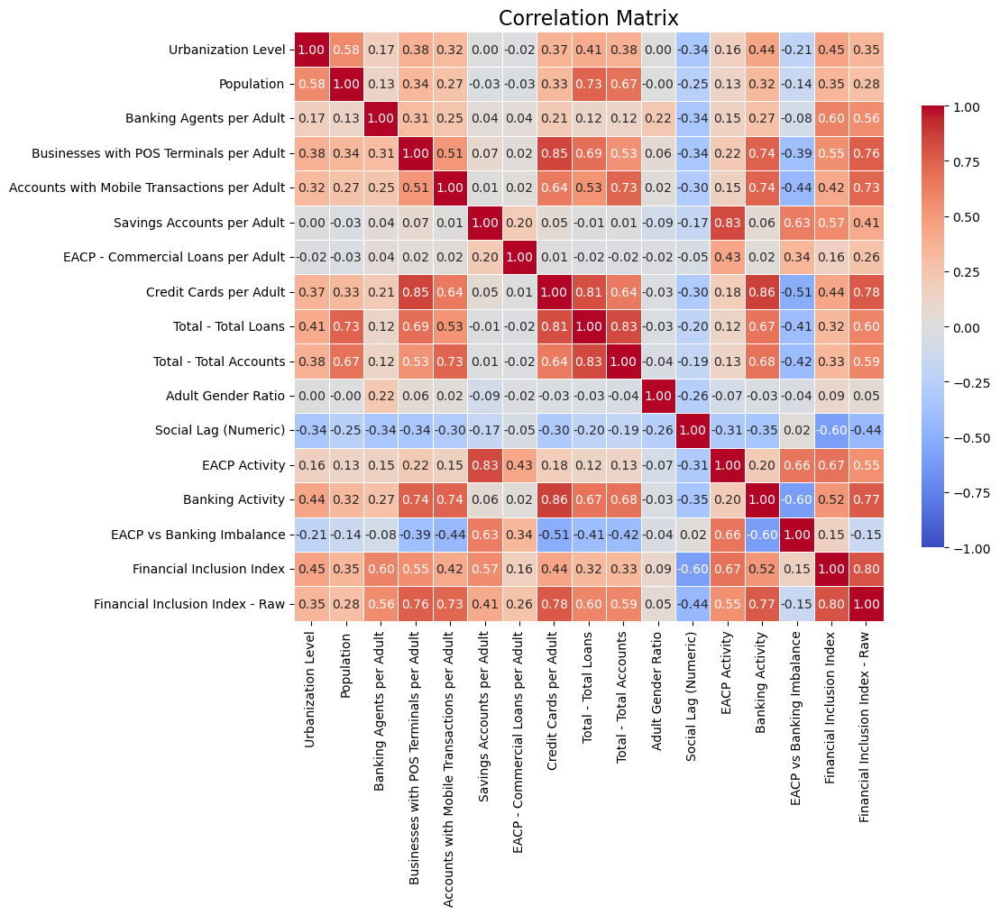

In [9]:
corr_columns = ['Urbanization Level', 'Population',
       'Banking Agents per Adult',
       'Businesses with POS Terminals per Adult',
       'Accounts with Mobile Transactions per Adult',
       'Savings Accounts per Adult',
       'EACP - Commercial Loans per Adult',
       'Credit Cards per Adult', 'Total - Total Loans', 'Total - Total Accounts',
       'Adult Gender Ratio', 'Social Lag (Numeric)', 'EACP Activity',
       'Banking Activity', 'EACP vs Banking Imbalance', 'Financial Inclusion Index',
       'Financial Inclusion Index - Raw']

correlation_matrix = main_df[corr_columns].corr()

import seaborn as sns
import matplotlib.pyplot as plt

# Create a heatmap of the correlation matrix
plt.figure(figsize=(12, 10))
sns.heatmap(
    correlation_matrix,
    annot=True,
    cmap='coolwarm',
    fmt=".2f",
    linewidths=0.5,
    vmin=-1,
    vmax=1,
    center=0,
    square=True,
    cbar_kws={"shrink": 0.75}
)
plt.title('Correlation Matrix', fontsize=16)
plt.tight_layout()
plt.show()

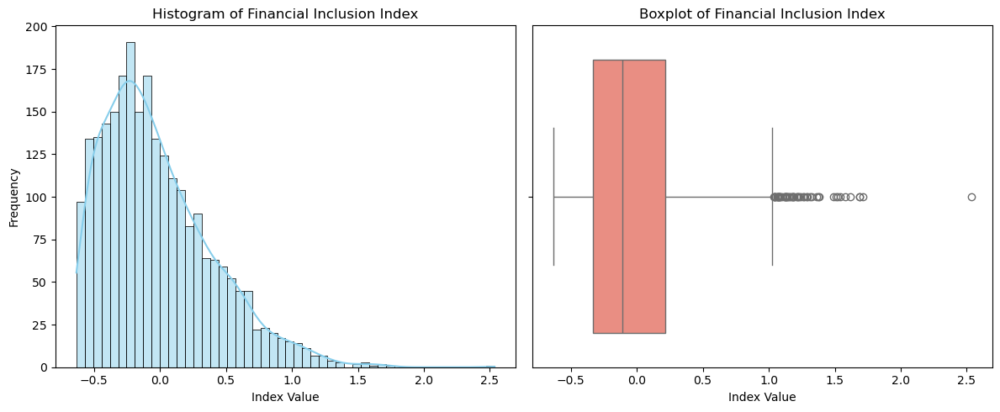

In [10]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(12, 5))

# Histogram
plt.subplot(1, 2, 1)
sns.histplot(main_df['Financial Inclusion Index'], bins=50, kde=True, color='skyblue')
plt.title('Histogram of Financial Inclusion Index')
plt.xlabel('Index Value')
plt.ylabel('Frequency')

# Boxplot
plt.subplot(1, 2, 2)
sns.boxplot(x=main_df['Financial Inclusion Index'], color='salmon')
plt.title('Boxplot of Financial Inclusion Index')
plt.xlabel('Index Value')

plt.tight_layout()
plt.show()


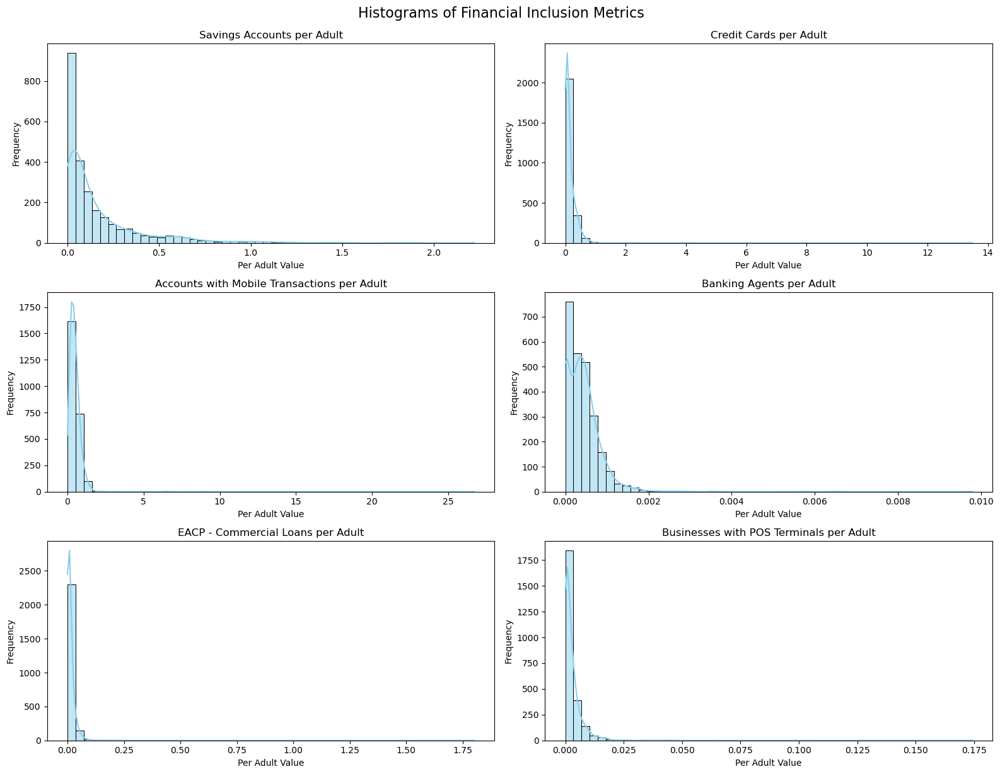

In [11]:
import matplotlib.pyplot as plt
import seaborn as sns

# Your Financial Inclusion metric columns
fi_metric_cols = [
    'Savings Accounts per Adult',
    'Credit Cards per Adult',
    'Accounts with Mobile Transactions per Adult',
    'Banking Agents per Adult',
    'EACP - Commercial Loans per Adult',
    'Businesses with POS Terminals per Adult'
]

# Set up a grid of histograms
plt.figure(figsize=(16, 12))

for i, col in enumerate(fi_metric_cols, 1):
    plt.subplot(3, 2, i)
    sns.histplot(main_df[col], bins=50, kde=True, color='skyblue')
    plt.title(col)
    plt.xlabel('Per Adult Value')
    plt.ylabel('Frequency')

plt.tight_layout()
plt.suptitle('Histograms of Financial Inclusion Metrics', fontsize=16, y=1.02)
plt.show()



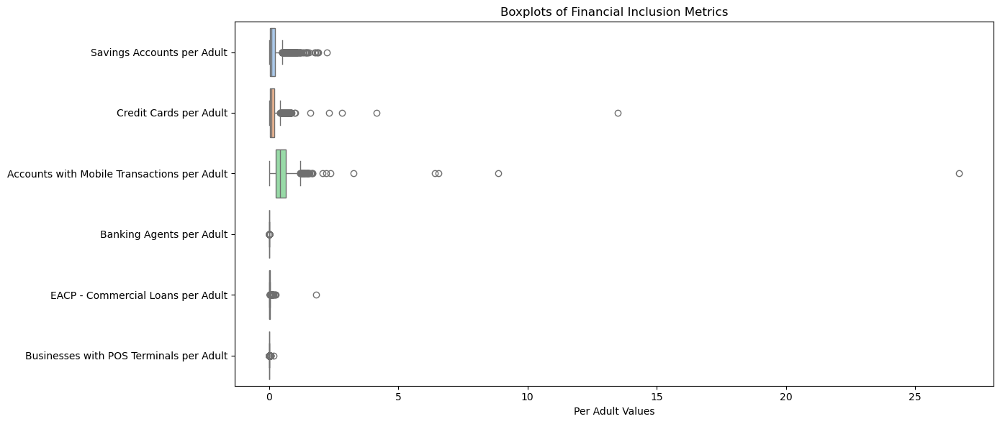

In [12]:
import matplotlib.pyplot as plt
import seaborn as sns

# List of your Financial Inclusion metric columns
fi_metric_cols = [
    'Savings Accounts per Adult',
    'Credit Cards per Adult',
    'Accounts with Mobile Transactions per Adult',
    'Banking Agents per Adult',
    'EACP - Commercial Loans per Adult',
    'Businesses with POS Terminals per Adult'
]

# Set up the plot
plt.figure(figsize=(14, 6))
sns.boxplot(data=main_df[fi_metric_cols], orient='h', palette='pastel')
plt.title('Boxplots of Financial Inclusion Metrics')
plt.xlabel('Per Adult Values')
plt.tight_layout()
plt.show()


In [13]:
# Your Financial Inclusion metric columns
fi_metric_cols = [
    'Savings Accounts per Adult',
    'Credit Cards per Adult',
    'Accounts with Mobile Transactions per Adult',
    'Banking Agents per Adult',
    'EACP - Commercial Loans per Adult',
    'Businesses with POS Terminals per Adult'
]

# Loop through each metric and print where the max occurs along with population
for col in fi_metric_cols:
    idx_max = main_df[col].idxmax()
    max_row = main_df.loc[idx_max, ['Municipality', 'State', col, 'Adult Population']]
    print(
        f"Max '{col}' occurs in {max_row['Municipality']}, {max_row['State']} "
        f"with value: {max_row[col]:.2f} and adult population: {max_row['Adult Population']:,}"
    )



Max 'Savings Accounts per Adult' occurs in Chavinda, Michoacán with value: 2.22 and adult population: 7,780
Max 'Credit Cards per Adult' occurs in Miguel Hidalgo, Ciudad de México with value: 13.48 and adult population: 346,049
Max 'Accounts with Mobile Transactions per Adult' occurs in Benito Juárez, Ciudad de México with value: 26.70 and adult population: 382,872
Max 'Banking Agents per Adult' occurs in San Pedro Mixtepec - Distr. 26 -, Oaxaca with value: 0.01 and adult population: 716
Max 'EACP - Commercial Loans per Adult' occurs in Mazatecochco de José María Morelos, Tlaxcala with value: 1.80 and adult population: 8,249
Max 'Businesses with POS Terminals per Adult' occurs in Miguel Hidalgo, Ciudad de México with value: 0.17 and adult population: 346,049


## Feature Engineering the INEGI ITER2020 Data

In [14]:
INEGI_df.columns

Index(['mun_code', 'NOM_ENT', 'NOM_MUN',
       'Total Occupied Private Households with Characteristics (2020)',
       'Total Population (2020)', 'Population Aged 5+', 'Population Aged 12+',
       'Population Aged 15+', 'Population Aged 18+',
       'Population Aged 60+ (2020)',
       'Average Number of Live-born Children per Woman (2020)',
       'Population Born in Another State (2020)',
       'Population Aged 5+ That Speaks an Indigenous Language (2020)',
       'Population Aged 5+ That Speaks Only an Indigenous Language (2020)',
       'Population in Indigenous Census Households (2020)',
       'Population That Identifies as Afro-Mexican or Afrodescendant (2020)',
       'Population with Disabilities (2020)',
       'Population Aged 15+ That Is Illiterate (2020)',
       'Population Aged 15+ Without Schooling (2020)',
       'Population Aged 15+ with Completed Primary Education (2020)',
       'Population Aged 15+ with Completed Secondary Education (2020)',
       'Average Year

In [15]:
## Process home characteristics columns. I'm using the term "homes" for brevity, but these stats do refer specifically to privately owned dwellings and do not include any form of public housing.
columns_to_process = [
    'Occupied Private Dwellings with Flooring Material Other Than Dirt (2020)',
    'Occupied Private Dwellings with Dirt Floor (2020)',
    'Occupied Private Dwellings with Electricity (2020)',
    'Occupied Private Dwellings with Running Water Inside the Home (2020)',
    'Occupied Private Dwellings with Toilet or Latrine (2020)',
    'Occupied Private Dwellings Without Electricity, Water, or Drainage (2020)',
    'Occupied Private Dwellings Without Car, Truck, Motorcycle, or Scooter (2020)',
    'Occupied Private Dwellings with Refrigerator (2020)',
    'Occupied Private Dwellings with Computer, Laptop, or Tablet (2020)',
    'Occupied Private Dwellings with Cell Phone (2020)',
    'Occupied Private Dwellings with Internet Access (2020)'
]

# Create new columns for percentages
for col in columns_to_process:
    new_col = col.replace('Occupied Private Dwellings', 'Homes').replace(' (2020)', '')
    main_df[f"% {new_col}"] = ((main_df[col] / main_df['Total Occupied Private Households with Characteristics (2020)']) * 100).round(2)


In [16]:
# Define column mappings: {original_column: (denominator_column, new_column_name)}
percentage_specs = {
    # Total Population
    'Population Aged 60+ (2020)': ('Total Population (2020)', '% Aged 60+'),
    'Population Born in Another State (2020)': ('Total Population (2020)', '% Born in Another State'),
    'Population in Indigenous Census Households (2020)': ('Total Population (2020)', '% in Indigenous Census Households'),
    'Population That Identifies as Afro-Mexican or Afrodescendant (2020)': ('Total Population (2020)', '% Afro-Mexican or Afrodescendant'),
    'Population with Disabilities (2020)': ('Total Population (2020)', '% with Disabilities'),
    'Population Without Health Service Affiliation (2020)': ('Total Population (2020)', '% Without Health Service Affiliation'),
    'Population with Catholic Religion (2020)': ('Total Population (2020)', '% Catholic Religion'),
    'Population with Protestant/Evangelical Christian Religion (2020)': ('Total Population (2020)', '% Protestant/Evangelical Christian Religion'),
    'Population with Other Religions (2020)': ('Total Population (2020)', '% Other Religions'),
    'Population Without Religion or Religious Affiliation (2020)': ('Total Population (2020)', '% Without Religion or Religious Affiliation'),

    # Population Aged 5+
    'Population Aged 5+ That Speaks an Indigenous Language (2020)': ('Population Aged 5+', '% Aged 5+ Speaking Indigenous Language'),
    'Population Aged 5+ That Speaks Only an Indigenous Language (2020)': ('Population Aged 5+', '% Aged 5+ Speaking Only an Indigenous Language'),

    # Population Aged 12+
    'Economically Active Population Aged 12+ (2020)': ('Population Aged 12+', '% Economically Active Aged 12+'),
    'Economically Inactive Population Aged 12+ (2020)': ('Population Aged 12+', '% Economically Inactive Aged 12+'),
    'Unemployed Population Aged 12+ (2020)': ('Population Aged 12+', '% Unemployed Aged 12+'),
    'Population Aged 12+ That Is Married or Cohabiting (2020)': ('Population Aged 12+', '% Aged 12+ That Is Married or Cohabiting'),

    # Population Aged 15+
    'Population Aged 15+ That Is Illiterate (2020)': ('Population Aged 15+', '% Aged 15+ Illiterate'),
    'Population Aged 15+ Without Schooling (2020)': ('Population Aged 15+', '% Aged 15+ Without Schooling'),
    'Population Aged 15+ with Completed Primary Education (2020)': ('Population Aged 15+', '% Aged 15+ with Completed Primary Education'),
    'Population Aged 15+ with Completed Secondary Education (2020)': ('Population Aged 15+', '% Aged 15+ with Completed Secondary Education'),

    # Population Aged 18+
    'Population Aged 18+ with Post-Basic Education (2020)': ('Population Aged 18+', '% Aged 18+ with Post-Basic Education'),
}

# Calculate percentages
for original_col, (denominator_col, new_col) in percentage_specs.items():
    main_df[new_col] = (main_df[original_col] / main_df[denominator_col]) * 100

# Round the new percentage columns to 2 decimal places
main_df[[new_col for _, (_, new_col) in percentage_specs.items()]] = main_df[
    [new_col for _, (_, new_col) in percentage_specs.items()]
].round(2)


In [17]:
main_df['% Homes with Computer, Laptop, or Tablet'].describe()

count    2469.000000
mean       18.003001
std        12.801762
min         0.000000
25%         8.280000
50%        14.940000
75%        25.070000
max        85.130000
Name: % Homes with Computer, Laptop, or Tablet, dtype: float64

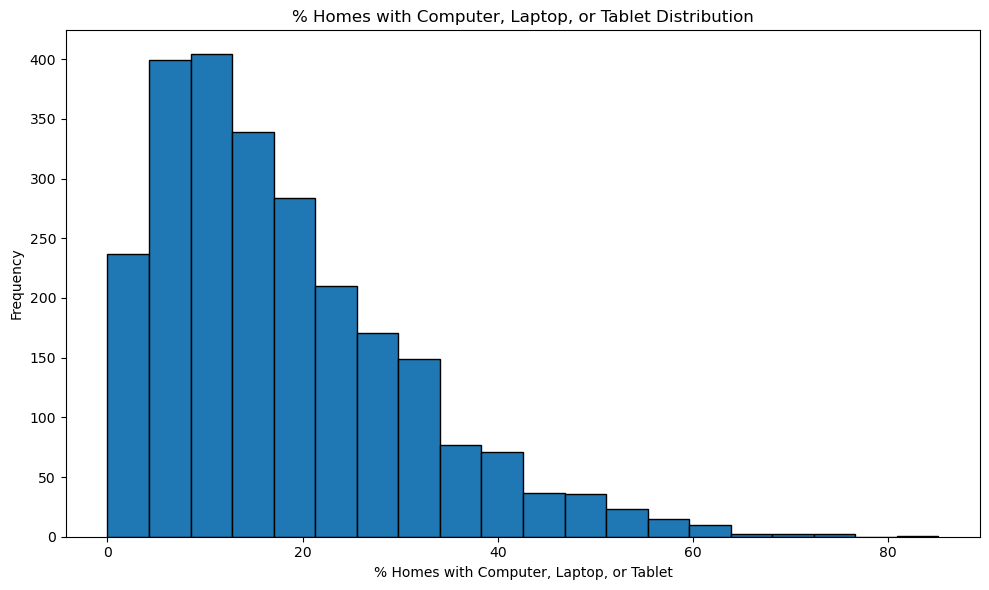

In [18]:
import matplotlib.pyplot as plt

# Create the histogram
plt.figure(figsize=(10, 6))
plt.hist(main_df['% Homes with Computer, Laptop, or Tablet'], bins=20, edgecolor='black')

# Add labels and title
plt.title('% Homes with Computer, Laptop, or Tablet Distribution')
plt.xlabel('% Homes with Computer, Laptop, or Tablet')
plt.ylabel('Frequency')

# Show the plot
plt.tight_layout()
plt.show()


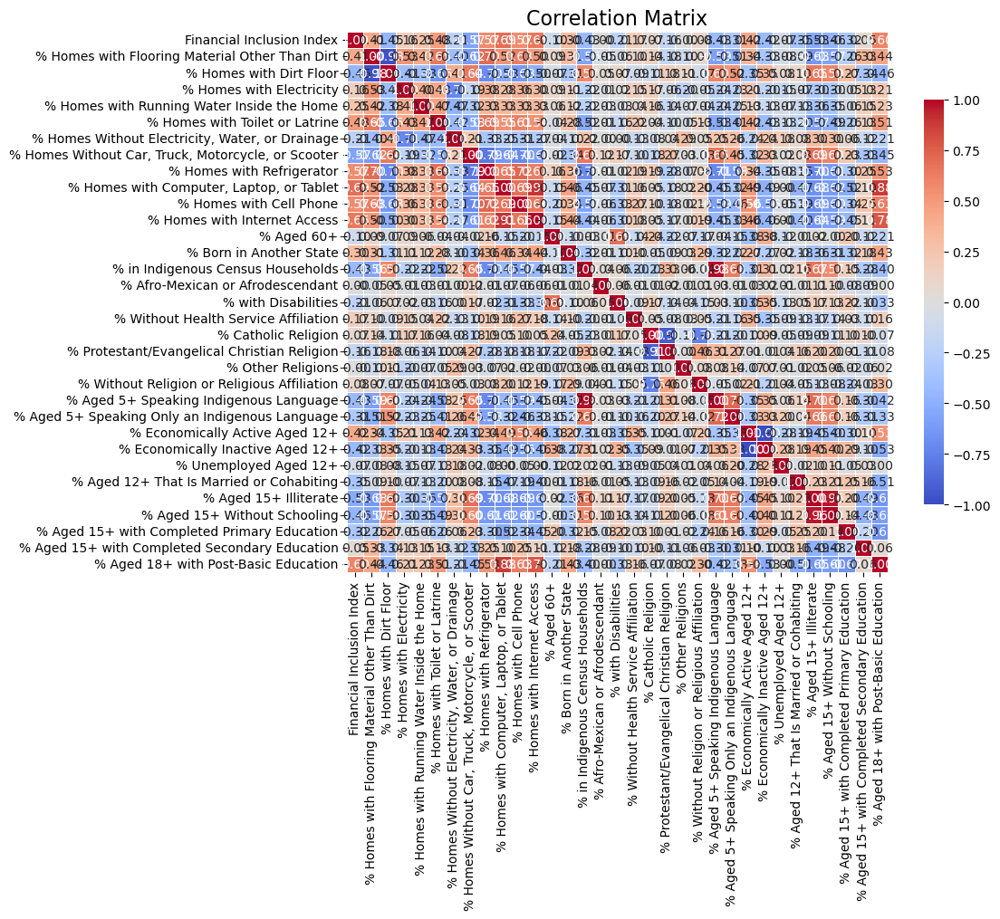

In [19]:
corr_columns = [
    'Financial Inclusion Index',
    '% Homes with Flooring Material Other Than Dirt',
    '% Homes with Dirt Floor',
    '% Homes with Electricity',
    '% Homes with Running Water Inside the Home',
    '% Homes with Toilet or Latrine',
    '% Homes Without Electricity, Water, or Drainage',
    '% Homes Without Car, Truck, Motorcycle, or Scooter',
    '% Homes with Refrigerator',
    '% Homes with Computer, Laptop, or Tablet',
    '% Homes with Cell Phone',
    '% Homes with Internet Access',
    '% Aged 60+',
    '% Born in Another State',
    '% in Indigenous Census Households',
    '% Afro-Mexican or Afrodescendant',
    '% with Disabilities',
    '% Without Health Service Affiliation',
    '% Catholic Religion',
    '% Protestant/Evangelical Christian Religion',
    '% Other Religions',
    '% Without Religion or Religious Affiliation',
    '% Aged 5+ Speaking Indigenous Language',
    '% Aged 5+ Speaking Only an Indigenous Language',
    '% Economically Active Aged 12+',
    '% Economically Inactive Aged 12+',
    '% Unemployed Aged 12+',
    '% Aged 12+ That Is Married or Cohabiting',
    '% Aged 15+ Illiterate',
    '% Aged 15+ Without Schooling',
    '% Aged 15+ with Completed Primary Education',
    '% Aged 15+ with Completed Secondary Education',
    '% Aged 18+ with Post-Basic Education',
]

correlation_matrix = main_df[corr_columns].corr()

import seaborn as sns
import matplotlib.pyplot as plt

# Create a heatmap of the correlation matrix
plt.figure(figsize=(12, 10))
sns.heatmap(
    correlation_matrix,
    annot=True,
    cmap='coolwarm',
    fmt=".2f",
    linewidths=0.5,
    vmin=-1,
    vmax=1,
    center=0,
    square=True,
    cbar_kws={"shrink": 0.75}
)
plt.title('Correlation Matrix', fontsize=16)
plt.tight_layout()
plt.show()

In [20]:
# Display correlation coefficients with the Financial Inclusion Index sorted by absolute value
print(correlation_matrix['Financial Inclusion Index'].loc[correlation_matrix['Financial Inclusion Index'].abs().sort_values(ascending=False).index])

Financial Inclusion Index                             1.000000
% Homes with Computer, Laptop, or Tablet              0.691170
% Homes with Internet Access                          0.654107
% Aged 18+ with Post-Basic Education                  0.600338
% Homes with Refrigerator                             0.569316
% Homes with Cell Phone                               0.569102
% Homes Without Car, Truck, Motorcycle, or Scooter   -0.567062
% Aged 15+ Illiterate                                -0.527920
% Homes with Toilet or Latrine                        0.478948
% Aged 15+ Without Schooling                         -0.461272
% Homes with Dirt Floor                              -0.449781
% in Indigenous Census Households                    -0.426260
% Aged 5+ Speaking Indigenous Language               -0.425263
% Economically Inactive Aged 12+                     -0.421919
% Economically Active Aged 12+                        0.417727
% Homes with Flooring Material Other Than Dirt        0

## Creating a geographical plot

In [21]:
main_df.columns

Index(['Municipality Code', 'State Code', 'Region', 'State', 'Municipality',
       'Population', 'Adult Population', 'Adult Population (Women)',
       'Adult Population (Men)', 'Type of Population',
       ...
       '% Aged 5+ Speaking Only an Indigenous Language',
       '% Economically Active Aged 12+', '% Economically Inactive Aged 12+',
       '% Unemployed Aged 12+', '% Aged 12+ That Is Married or Cohabiting',
       '% Aged 15+ Illiterate', '% Aged 15+ Without Schooling',
       '% Aged 15+ with Completed Primary Education',
       '% Aged 15+ with Completed Secondary Education',
       '% Aged 18+ with Post-Basic Education'],
      dtype='object', length=155)

In [22]:
with open('datasets\gadm41_MEX_2.geojson', 'r') as f:
    geojson = json.load(f)

In [23]:
geojson

{'type': 'FeatureCollection',
 'name': 'gadm41_MEX_2',
 'crs': {'type': 'name',
  'properties': {'name': 'urn:ogc:def:crs:OGC:1.3:CRS84'}},
 'features': [{'type': 'Feature',
   'properties': {'GID_2': 'MEX.1.1_2',
    'GID_0': 'MEX',
    'COUNTRY': 'México',
    'GID_1': 'MEX.1_1',
    'NAME_1': 'Aguascalientes',
    'NL_NAME_1': 'NA',
    'NAME_2': 'Aguascalientes',
    'VARNAME_2': 'NA',
    'NL_NAME_2': 'NA',
    'TYPE_2': 'Município',
    'ENGTYPE_2': 'Municipality',
    'CC_2': 'NA',
    'HASC_2': 'NA'},
   'geometry': {'type': 'MultiPolygon',
    'coordinates': [[[[-102.0978, 22.0232],
       [-102.0986, 22.014],
       [-102.0974, 22.0128],
       [-102.0972, 21.9961],
       [-102.0847, 21.986],
       [-102.0687, 21.9779],
       [-102.0709, 21.974],
       [-102.0682, 21.971],
       [-102.0694, 21.969],
       [-102.0943, 21.9723],
       [-102.0924, 21.9611],
       [-102.0973, 21.9609],
       [-102.1009, 21.9649],
       [-102.1005, 21.9727],
       [-102.1319, 21.9768],


In [24]:
geojson['features'][0]['properties']

{'GID_2': 'MEX.1.1_2',
 'GID_0': 'MEX',
 'COUNTRY': 'México',
 'GID_1': 'MEX.1_1',
 'NAME_1': 'Aguascalientes',
 'NL_NAME_1': 'NA',
 'NAME_2': 'Aguascalientes',
 'VARNAME_2': 'NA',
 'NL_NAME_2': 'NA',
 'TYPE_2': 'Município',
 'ENGTYPE_2': 'Municipality',
 'CC_2': 'NA',
 'HASC_2': 'NA'}

In [25]:
## Clean state/municipality names so the dataframe can match the geojson
# dataframe clean
main_df['muni_clean'] = main_df['Municipality'].str.lower().apply(unidecode.unidecode).str.strip()
main_df['state_clean'] = main_df['State'].str.lower().apply(unidecode.unidecode).str.strip()

# geojson clean
for feature in geojson['features']:
    feature['properties']['muni_clean'] = unidecode.unidecode(feature['properties']['NAME_2'].lower().strip())
    feature['properties']['state_clean'] = unidecode.unidecode(feature['properties']['NAME_1'].lower().strip())


In [26]:
for feature in geojson['features']:
    feature['id'] = f"{feature['properties']['state_clean']}|{feature['properties']['muni_clean']}"

# And add the same to your DataFrame
main_df['region_id'] = main_df['state_clean'] + "|" + main_df['muni_clean']


In [27]:
import plotly.express as px

fig = px.choropleth(
    main_df,
    geojson=geojson,
    locations='region_id',
    color='Savings Accounts per Adult',  # or another financial inclusion metric
    featureidkey="properties.id",  # tells plotly where to match 'region_id'
    projection="mercator"
)

fig.update_geos(fitbounds="locations", visible=True)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()
